In [2]:
import numpy as np 
import matplotlib.pyplot as plt

 # 1. Euler'e Method: Simple Pendulum 

Euler's method is a very intuitive way to thing about how ODEs evolve, step by step. We consider the folowing general form of an ODE: 
$$\frac{dx}{dt} = f(t,x(t)).$$
Discretely, we write it as
$$ x(t + s) = x(t) + f(t,x(t))s, $$
or even 

$$ x_{n+1} = x_n + sf(t_n,x_n),$$
where, $t_{n+1} = t_n + s$.


## Step-by-step 

Like Jack The Ripper, we have to go by parts. 

1. Separate our problem into 2 couples 1st order ODEs: 
$$ 
\theta(t+s) = \theta(t) + \omega(t)s \\
\omega(t + s) = \omega(s) - \frac{g}{L}\sin(\theta(t))s
$$

*TIP:* Before writing any code on the computer, try to sketch a pseudo-code writing down explicitely, in words, what the code is gonna do. 


In [3]:
# constants

g = 9.8
L = 1

N_steps = 10000
h = 0.001 


time = np.zeros(N_steps)
theta = np.zeros(N_steps)
omega = np.zeros(N_steps)
E = np.zeros(N_steps)

theta[0] = 1
omega[0] = 0
E[0] = 0.5*L**2*omega[0] + g*L*g*(1-np.cos(theta[0]))

for t in range(0,N_steps-1):
    time[t+1] = time[t] + h
    omega[t+1] = omega[t] - g/L*np.sin(theta[t])*h
    theta[t+1] = theta[t] +  omega[t]*h
    E[t+1] = 0.5*L**2*omega[t+1]**2 + g*L*(1-np.cos(theta[t+1]))
    


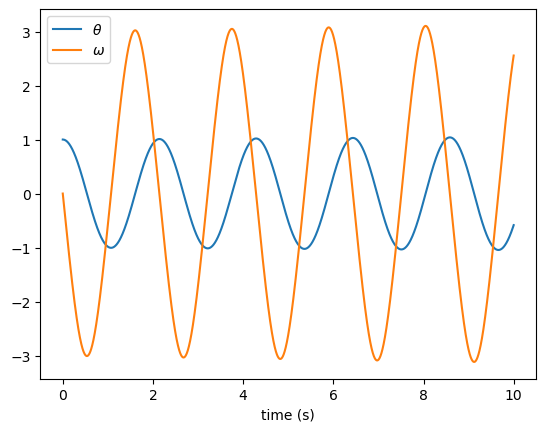

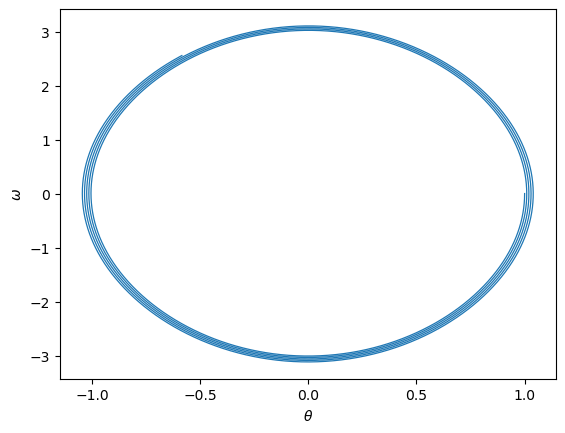

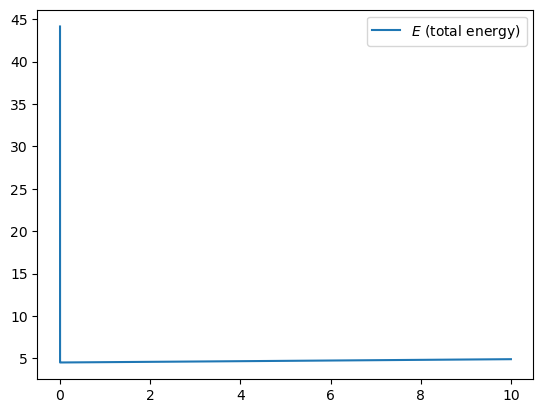

In [5]:
    
    
plt.plot(time,theta,label=r'$\theta$')
plt.plot(time,omega,label=r'$\omega$')
plt.xlabel('time (s)')

plt.legend()
plt.show()

plt.plot(theta,omega,lw=0.9)
plt.xlabel(r'$\theta$')
plt.ylabel(r'$\omega$')
# plt.plot(time,omega,label=r'$\omega$')
plt.show()

plt.plot(time,E,label=r'$E$ (total energy)')
# plt.plot(time,omega,label=r'$\omega$')
plt.legend()
plt.show()

/tmp/ipykernel_66910/1654636785.py:21: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  dot.set_data(x[i], y[i])  # Dot at the end of the line
Animation size has reached 20979258 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


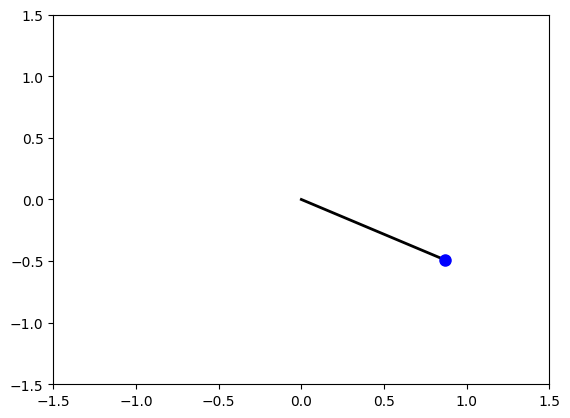

In [43]:
from matplotlib.animation import FuncAnimation
x = L*np.cos(theta)
y = L*np.sin(theta)

fig, ax = plt.subplots()
ax.set_xlim(-1.5, 1.5)  # Set x-axis limits
ax.set_ylim(-1.5, 1.5)
line, = ax.plot([], [], '-', color='black', lw=2)  # Line from pivot to the pendulum
dot, = ax.plot([], [], 'o', color='blue', markersize=8)  # Dot at the end of the line

# Initialization function
def init():
    line.set_data([], [])
    dot.set_data([], [])
    return line, dot

# Animation function
def animate(i):
    # Update the line and dot position
    line.set_data([0, x[i]], [0, y[i]])  # Line from pivot (0, 0) to (x[i], y[i])
    dot.set_data(x[i], y[i])  # Dot at the end of the line
    return line, dot

ani = FuncAnimation(
    fig, animate, init_func=init, frames=np.arange(0,100), interval=100, blit=False
)
from IPython.display import HTML
HTML(ani.to_jshtml())

# 2. Runge-Kutta

In [6]:
timeRK = np.zeros(N_steps)
thetaRK = np.zeros(N_steps)
omegaRK = np.zeros(N_steps)
E_RK= np.zeros(N_steps)

thetaRK[0] = 1
omegaRK[0] = 0
E_RK[0] = 0.5*L**2*omegaRK[0] + g*L*g*(1-np.cos(thetaRK[0]))

for t in range(N_steps-1):
    timeRK[t+1] = timeRK[t] + h
    k1 = -g/L*np.sin(thetaRK[t])
    y1 = thetaRK[t]+k1*h/2
    k2 = -g/L*np.sin(y1)
    omegaRK[t+1] = omegaRK[t] + k2*h
    thetaRK[t+1] = thetaRK[t] + omegaRK[t]*h
    E_RK[t+1] = 0.5*L**2*omegaRK[t+1]**2 + g*L*(1-np.cos(thetaRK[t+1]))
    

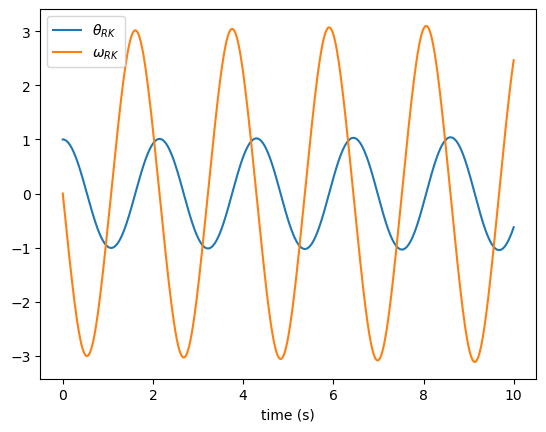

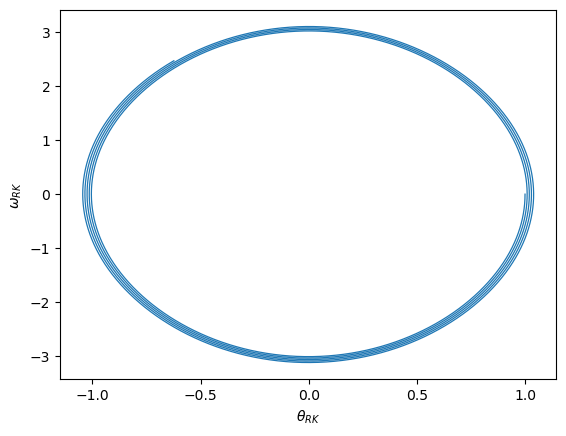

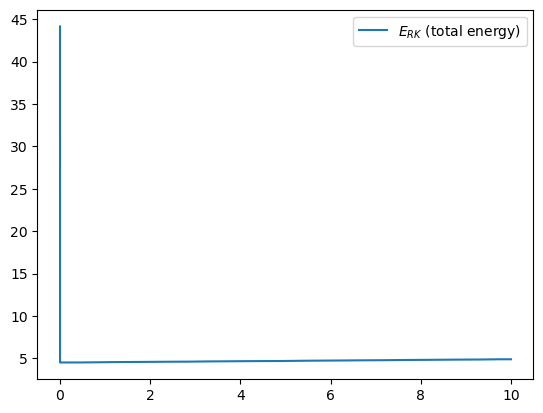

In [7]:
    
    
plt.plot(timeRK,thetaRK,label=r'$\theta_{RK}$')
plt.plot(timeRK,omegaRK,label=r'$\omega_{RK}$')
plt.xlabel('time (s)')

plt.legend()
plt.show()

plt.plot(thetaRK,omegaRK,lw=0.9)
plt.xlabel(r'$\theta_{RK}$')
plt.ylabel(r'$\omega_{RK}$')
# plt.plot(time,omega,label=r'$\omega$')
plt.show()

plt.plot(timeRK,E_RK,label=r'$E_{RK}$ (total energy)')
# plt.plot(time,omega,label=r'$\omega$')
plt.legend()
plt.show()